In [19]:
from Utilities import load_data, select_sample
from MPGA import MPGA
import json

# Exemple d'utilisation
file_path = 'WTI_Spot_Price_daily.csv'
data = load_data(file_path)

time_start = "04/01/2003"  # date de début (exemple)
time_end = "01/02/2008"    # date de fin (exemple)

sample = select_sample(data, time_start, time_end)

mpga = MPGA(sample, "daily")

results = mpga.fit()

# Save results to a JSON file
with open("results_1st_interval.json", "w") as f:
    json.dump(results, f, indent=4)

In [6]:
import numpy as np

def compute_linear_params(t, y, t_c, alpha, omega, phi):
    """
    Placeholder that returns (A, B, C) for the subinterval data.

    You should implement the actual linear regression (Eq. 5 in your references),
    i.e. solve the system using f_j, g_j, etc.
    """

    dt = t_c - t
    f = dt ** alpha
    g = f * np.cos(omega * np.log(dt) + phi)

    # Build design matrix
    V = np.column_stack((np.ones_like(f), f, g))
 
    return np.linalg.inv(V.T @ V) @ (V.T @ y)

def compute_residuals(t, y, A, B, t_c, alpha):
    """
    Return the array x_j = y_j - [A + B(...) + C(...)cos(...)], for j=1..J
    """
    dt = t_c - t
    f = dt ** alpha
    residuals = y - A - B*f
    return residuals

def lomb_power_spectrum(t, x, freq_array):
    """
    Compute the Lomb-Scargle periodogram P(f) for each f in freq_array.

    Parameters
    ----------
    t          : 1D array of time points t_j
    x          : 1D array of residuals x_j
    freq_array : 1D array of candidate frequencies f_i

    Returns
    -------
    power_spectrum : 1D array of P(f_i) for each frequency f_i
    """
    J = len(t)
    x_mean = np.mean(x)
    sigma2 = np.sum((x - x_mean)**2) / (J - 1)

    power_spectrum = np.zeros_like(freq_array)

    # Precompute some sums for speed if desired; for clarity, do it directly:
    for i, f in enumerate(freq_array):
        # Time shift tau
        sum_sin = 0.0
        sum_cos = 0.0
        for j in range(J):
            sum_sin += np.sin(4.0 * np.pi * f * t[j])
            sum_cos += np.cos(4.0 * np.pi * f * t[j])
        tau = (1.0 / (4.0 * np.pi * f)) * np.arctan2(sum_sin, sum_cos)

        # Numerators
        Nc = 0.0
        Ns = 0.0
        # Denominators
        Dc = 0.0
        Ds = 0.0

        for j in range(J):
            arg = 2.0 * np.pi * f * (t[j] - tau)
            xc = (x[j] - x_mean) * np.cos(arg)
            xs = (x[j] - x_mean) * np.sin(arg)
            Nc += xc
            Ns += xs
            Dc += np.cos(arg)**2
            Ds += np.sin(arg)**2

        # P(f)
        P_f = (1.0 / (2.0 * sigma2)) * ( (Nc**2 / Dc) + (Ns**2 / Ds) )
        power_spectrum[i] = P_f

    return power_spectrum


def filter_lomb_results(freq_array, power_array, J, p=0.95):
    """
    Remove invalid frequencies from the Lomb-Scargle result.
    1) Remove f_mpf ~ 1.5 / J
    2) Remove values below critical threshold.
    3) Return "filtered" freq and power arrays.
    """
    M = len(freq_array)

    # 1) f_mpf ~ 1.5/J
    mpf = 1.5 / J

    # 2) critical threshold:
    #    z = -ln(1 - (1 - p)^(1/M))
    #    -> if power < z, discard
    z = -np.log(1.0 - (1.0 - p)**(1.0 / M))

    filtered_f = []
    filtered_p = []
    for f, pwr in zip(freq_array, power_array):
        # skip if near f_mpf:
        if abs(f - mpf) < 1e-6:  
            continue
        # skip if pwr < z
        if pwr < z:
            continue
        filtered_f.append(f)
        filtered_p.append(pwr)

    return np.array(filtered_f), np.array(filtered_p)

def lomb_validation_for_subinterval(
    t, y,
    t_c, omega, phi, alpha,
    # Possibly we need A,B,C or we compute them:
    compute_linear=True,
    param_func=compute_linear_params,  # Placeholder to get (A,B,C)
    freq_array=np.linspace(0.001, 1.0, 500),  # Example freq range
    p=0.95
):
    """
    Perform Lomb-Scargle on x_j for a single subinterval and decide if the
    predicted turning point is valid.

    Returns: (is_valid, best_freq, best_power)
    """
    dt = t_c - t
    f = dt ** alpha
    g = f * np.cos(omega * np.log(dt) + phi)

    # Build design matrix
    V = np.column_stack((np.ones_like(f), f, g))
 
    A, B, C = np.linalg.inv(V.T @ V) @ (V.T @ y)

    # 2) Build x_j
    x = compute_residuals(t, y, A, B, C, t_c, alpha, omega, phi)

    # 3) Compute Lomb periodogram
    P = lomb_power_spectrum(t, x, freq_array)

    # 4) Filter invalid freq
    f_filt, P_filt = filter_lomb_results(freq_array, P, len(t), p=p)

    if len(f_filt) == 0:
        # no valid freq => invalid subinterval
        return (False, None, None)

    # 5) Identify peak frequency
    idx_peak = np.argmax(P_filt)
    best_freq = f_filt[idx_peak]
    best_power = P_filt[idx_peak]

    # 6) Compare best_freq ~ (omega / 2pi)
    #    Some tolerance: e.g., 5% difference
    target_freq = omega / (2.0 * np.pi)
    relative_diff = abs(best_freq - target_freq) / target_freq

    is_valid = (relative_diff < 0.05)  # or pick a suitable threshold
    return (is_valid, best_freq, best_power)

In [73]:
import numpy as np

def compute_linear_params(t, y, t_c, alpha, omega, phi):
    """
    Placeholder that returns (A, B, C) for the subinterval data.

    You should implement the actual linear regression (Eq. 5 in your references),
    i.e. solve the system using f_j, g_j, etc.
    """

    dt = t_c - t
    f = dt ** alpha
    g = f * np.cos(omega * np.log(dt) + phi)

    # Build design matrix
    V = np.column_stack((np.ones_like(f), f, g))
 
    return np.linalg.inv(V.T @ V) @ (V.T @ y)

def compute_residuals(t, y, A, B, t_c, alpha):
    """
    Return the array x_j = y_j - [A + B(...) + C(...)cos(...)], for j=1..J
    """
    dt = t_c - t
    f = dt ** alpha
    residuals = y - A - B*f
    return residuals

def lomb_periodogram(t, x, freqs, p=0.95):
    """
    Perform Lomb periodogram analysis for the given time series x at times t with a set of frequencies.

    Parameters:
    - t: Time points (array)
    - x: Observed values (array)
    - freqs: Frequency series to test (array)
    - p: Statistical significance level (default 0.95)

    Returns:
    - P: Power spectral density for each frequency in freqs
    - valid_freq: The frequency with the highest valid power
    """
    J = len(t)
    mean_x = 1/J * np.sum(x)  # mean of x
    var_x = 1/(J-1) * np.sum((x - mean_x) **2) # variance of x
    P = []

    # Compute the Lomb periodogram for each frequency
    for f in freqs:
        # Calculate time offset t
        sin_term = np.sum(np.sin(4 * np.pi * f * t))
        cos_term = np.sum(np.cos(4 * np.pi * f * t))
        t_offset = (1 / (4 * np.pi * f)) * np.arctan(sin_term / cos_term)

        # Calculate power spectral density P(f)
        cos_num = np.sum((x - mean_x) * np.cos(2 * np.pi * f * (t - t_offset))) ** 2
        cos_denom = np.sum(np.cos(2 * np.pi * f * (t - t_offset)) ** 2)
        sin_num = np.sum((x - mean_x) * np.sin(2 * np.pi * f * (t - t_offset))) ** 2
        sin_denom = np.sum(np.sin(2 * np.pi * f * (t - t_offset)) ** 2)
        power = (cos_num/cos_denom + sin_num/sin_denom) / (2 * var_x)
        P.append(power)

    # Convert to array for convenience
    P = np.array(P)

    # Calculate critical value based on statistical significance level p
    M = len(freqs)
    critical_value = -np.log(1 - (1 - p) ** (1 / M))

    # Find valid frequencies based on power being greater than the critical value
    valid_freqs = freqs[P > critical_value]

    # If no valid frequencies, return None
    if len(valid_freqs) == 0:
        return None, None

    # Select the frequency with the maximum power
    max_power_idx = np.argmax(P)
    valid_freq = freqs[max_power_idx]

    return P, valid_freq, critical_value

def filter_lomb_results(freq_array, power_array, J, p=0.95):
    """
    Remove invalid frequencies from the Lomb-Scargle result.
    1) Remove f_mpf ~ 1.5 / J
    2) Remove values below critical threshold.
    3) Return "filtered" freq and power arrays.
    """
    M = len(freq_array)

    # 1) f_mpf ~ 1.5/J
    mpf = 1.5 / J

    # 2) critical threshold:
    #    z = -ln(1 - (1 - p)^(1/M))
    #    -> if power < z, discard
    z = -np.log(1.0 - (1.0 - p)**(1.0 / M))

    filtered_f = []
    filtered_p = []
    for f, pwr in zip(freq_array, power_array):
        # skip if near f_mpf:
        if abs(f - mpf) < 1e-6:  
            continue
        # skip if pwr < z
        if pwr < z:
            continue
        filtered_f.append(f)
        filtered_p.append(pwr)

    return np.array(filtered_f), np.array(filtered_p)

validated_solutions = []

t = np.linspace(0, len(data) - 1, len(data))

data = np.insert(data, 0, t, axis=1)

data = data[:, [0, 2]].astype(float)

global_time = data[:, 0]
global_price = data[:, 1]

import numpy as np
from astropy.timeseries import LombScargle
import matplotlib.pyplot as plt

for i in range(len(results['subintervals'])):

    t_start = results['subintervals'][i]['sub_start']
    t_end = results['subintervals'][i]['sub_end']
    rss_val = results['subintervals'][i]['bestObjV']
    params = results['subintervals'][i]['bestChrom']
    tc, omega, phi, alpha = params

    freqs = np.linspace(0.01, 1, 1000)
    # 1) Extract your subinterval data from the global dataset
    #    Or if you already have it, just pass it in directly.
    mask = (global_time >= t_start) & (global_time <= t_end)
    t_sub = global_time[mask]
    y_sub = global_price[mask]

    A, B, C = compute_linear_params(t_sub, y_sub, tc, alpha, omega, phi)

    residuals = compute_residuals(t_sub, y_sub, A, B, tc, alpha)

    # 2) Perform Lomb validation
    P, test, critical_value = lomb_periodogram(t_sub, residuals, freqs)

    print(P)
    lombscargle = LombScargle(t_sub, residuals)
    P = lombscargle.power(freqs)
    print(P)
    # 3) Filter invalid results
    f_filt, P_filt = filter_lomb_results(freqs, P, len(t_sub))
    
    print(f_filt)
    # # Trouver la fréquence avec la puissance maximale
    # best_frequency = frequency[np.argmax(P)]
    # print(f"Best frequency: {best_frequency}")
    # print(1.5/len(t_sub))

    # target_freq = omega / (2.0 * np.pi)
    # print(f"Omega: {omega}")
    # print(f"Target frequency: {target_freq}")

    # fig, ax1 = plt.subplots()

    # # Tracer le periodogramme de Lomb-Scargle
    # ax1.plot(frequency, power, 'b-')
    # ax1.set_xlabel('Frequency')
    # ax1.set_ylabel('Power', color='b')
    # ax1.tick_params('y', colors='b')

    # # rajouter une ligne verticale pour la fréquence cible
    # ax1.axvline(x=target_freq, color='r', linestyle='--')

    # # Créer un deuxième axe y pour freqs, P
    # ax2 = ax1.twinx()
    # ax2.plot(freqs, P, 'g-')
    # ax2.set_ylabel('Lomb Power', color='g')
    # ax2.tick_params('y', colors='g')

    # plt.title('Lomb-Scargle Periodogram')
    # plt.show()

    def lppl(t, A, B, tc, alpha, C, omega, phi):
        return A + B * (tc - t) ** alpha + C * (tc - t) ** alpha * np.cos(omega * np.log(tc - t) + phi)
    if len(f_filt) != 0:

        # 5) Identify peak frequency
        idx_peak = np.argmax(P_filt)
        best_freq = f_filt[idx_peak]
        best_power = P_filt[idx_peak]

        print(f"Best frequency: {best_freq}, Best power: {best_power}")
        # 6) Compare best_freq ~ (omega / 2pi)
        #    Some tolerance: e.g., 5% difference
        target_freq = omega / (2.0 * np.pi)
        relative_diff = abs(best_freq - target_freq) / target_freq
        print(f"Target frequency: {target_freq}")
        print(f"Relative difference: {relative_diff}")


        is_valid = (relative_diff < 0.05)  # or pick a suitable threshold
        if is_valid:
            print("Valid solution for i =", i)

        plt.plot(f_filt, P_filt)
        plt.xlabel('Frequency')
        plt.ylabel('Power')
        plt.title('Lomb Periodogram')
        plt.show()

import matplotlib.pyplot as plt

# # Plot the results from 0.1 to 0.9
# plt.plot(f_filt, P_filt)
# plt.xlabel('Frequency')
# plt.ylabel('Power')
# plt.title('Lomb Periodogram')
# plt.show()
# 3) Keep if valid
#validated_solutions.append((t_start, t_end, rss_val, params, freq_peak, pwr_peak, is_valid))


[2.48915290e+00 2.01711184e+00 7.89856482e-01 4.82214176e-02
 2.52902634e-01 8.40274630e-01 1.04586937e+00 6.78189701e-01
 1.65915097e-01 2.01916964e-02 2.71401545e-01 5.47412880e-01
 5.23780104e-01 2.46750789e-01 2.33810269e-02 6.07803783e-02
 2.59147776e-01 3.68560364e-01 2.68853720e-01 8.00163557e-02
 4.83614036e-03 9.85255838e-02 2.27474659e-01 2.40872366e-01
 1.27142033e-01 1.62499576e-02 2.21948108e-02 1.18286466e-01
 1.85181659e-01 1.46643251e-01 5.01705614e-02 2.06034343e-03
 4.60145487e-02 1.21404390e-01 1.38926996e-01 7.99886081e-02
 1.34178341e-02 9.46560242e-03 6.48746310e-02 1.10706703e-01
 9.41140032e-02 3.61940619e-02 1.54597928e-03 2.46041332e-02
 7.29814775e-02 9.01552846e-02 5.64619380e-02 1.15081448e-02
 4.22768126e-03 3.86007370e-02 7.20389010e-02 6.62668442e-02
 2.83020321e-02 1.63248355e-03 1.38542933e-02 4.75779116e-02
 6.31060626e-02 4.27591298e-02 1.04418595e-02 1.98038915e-03
 2.43755947e-02 4.99511923e-02 4.93254919e-02 2.31775284e-02
 1.84990587e-03 8.160472

/var/folders/vk/z0p4r5z97d99dp7mpbt9yd1w0000gn/T/ipykernel_10442/1183074086.py:53: RuntimeWarning: divide by zero encountered in scalar divide
  t_offset = (1 / (4 * np.pi * f)) * np.arctan(sin_term / cos_term)


[1.20723583e+00 5.14101984e+00 5.77143393e-01 3.77615595e+00
 4.62962566e-02 3.29161846e+00 6.11494788e-02 2.23851937e+00
 2.31827466e-01 1.66479135e+00 3.68501988e-01 9.51600878e-01
 3.77162997e-01 3.38862525e-01 7.33295876e-01 2.06788030e-01
 5.83768880e-01 5.69170772e-02 1.08528618e+00 6.56082639e-02
 7.51601514e-01 6.51203586e-02 7.48104297e-01 8.33114284e-02
 5.44939231e-01 1.57596569e-01 4.54527705e-01 1.79252994e-01
 2.40643197e-01 3.12327159e-01 1.67161264e-01 3.39656607e-01
 7.08588377e-02 4.06035480e-01 5.33692551e-02 3.46039101e-01
 1.48630377e-02 2.99397184e-01 4.71876174e-02 5.15910253e-01
 3.55463665e-03 1.72001638e-01 8.58956093e-02 2.17488872e-01
 9.97312410e-02 1.44556540e-01 8.69027214e-02 5.05120966e-02
 1.68133322e-01 3.97715354e-02 1.88514869e-01 1.82801296e-02
 1.18788534e-01 6.13123049e-03 1.84705304e-01 5.36673964e-03
 1.16929439e-01 2.33499433e-02 8.08803263e-02 4.54526442e-02
 4.48909426e-02 8.73827548e-02 3.40834939e-02 8.96040156e-02
 1.21982133e-02 1.446101

In [4]:
import numpy as np
import matplotlib.pyplot as plt
from astropy.timeseries import LombScargle

class LombAnalysis:
    """
    A class to perform Lomb-Scargle periodogram analysis on a time series,
    optionally using linear-parameter fitting and residual computation.

    Typical Workflow:
      1. Instantiate with time (t), values (x), and a set of candidate frequencies.
      2. (Optional) compute_linear_params(...) + compute_residuals(...) to get the residual series.
      3. run_lomb() or compute_lomb_periodogram() to get the Lomb-Scargle powers.
      4. filter_results(...) to discard frequencies deemed invalid.
      5. show_spectrum(...) to visualize the final power spectrum and highlight results.
    """

    def __init__(self,
                 t: np.ndarray,
                 x: np.ndarray,
                 freqs: np.ndarray,
                 significance_level: float = 0.95):
        """
        Initialize the LombAnalysis with time-series data and candidate frequencies.

        Parameters
        ----------
        t : np.ndarray
            1D array of time points, shape (N,).
        x : np.ndarray
            1D array of observed values (e.g., residuals), shape (N,).
        freqs : np.ndarray
            1D array of candidate frequencies for which to compute the Lomb-Scargle power.
        significance_level : float, optional
            Statistical significance level p in [0,1], default=0.95.

        Raises
        ------
        ValueError
            If t and x have different lengths, or freqs is empty.
        """
        if t.shape[0] != x.shape[0]:
            raise ValueError("Time array (t) and data array (x) must be the same length.")
        if len(freqs) == 0:
            raise ValueError("The frequency array cannot be empty.")

        self.t = t
        self.x = x
        self.freqs = freqs
        self.significance_level = significance_level

        self.power = None  # Will hold the Lomb-Scargle power array
        self.critical_value = None  # Will store the significance threshold
        self.filtered_freqs = None  # After filtering
        self.filtered_power = None

    @staticmethod
    def compute_linear_params(t: np.ndarray,
                              y: np.ndarray,
                              t_c: float,
                              alpha: float,
                              omega: float,
                              phi: float) -> tuple[float, float, float]:
        """
        Compute linear parameters (A, B, C) for a simplified LPPL model:

            y(t) ~ A + B*(t_c - t)^alpha + C*(t_c - t)^alpha*cos(omega ln(t_c - t) + phi)

        using linear regression on a sub-interval.

        Parameters
        ----------
        t : np.ndarray
            1D array of time points, shape (N,).
        y : np.ndarray
            1D array of observed data, shape (N,).
        t_c : float
        alpha : float
        omega : float
        phi : float

        Returns
        -------
        (A, B, C) : tuple of floats
            Solved from the normal equations (V^T V)(A,B,C)^T = (V^T y).
        """
        dt = t_c - t
        f = dt ** alpha
        g = f * np.cos(omega * np.log(dt) + phi)

        # Build design matrix
        V = np.column_stack((np.ones_like(f), f, g))
        # Solve [A, B, C] via linear algebra
        params = np.linalg.inv(V.T @ V) @ (V.T @ y)
        A, B, C = params
        return A, B, C

    @staticmethod
    def compute_residuals(t: np.ndarray,
                          y: np.ndarray,
                          A: float,
                          B: float,
                          t_c: float,
                          alpha: float,
                          C: float = 0.0,
                          omega: float = 0.0,
                          phi: float = 0.0,
                          include_oscillation: bool = False) -> np.ndarray:
        """
        Compute the residuals after subtracting a fitted LPPL-like model:
            y(t) = A + B*(t_c - t)^alpha + [C*(t_c - t)^alpha*cos(omega*ln(t_c - t) + phi)] if needed.

        Parameters
        ----------
        t : np.ndarray, shape (N,)
            Time points.
        y : np.ndarray, shape (N,)
            Observed data.
        A, B : float
            Linear parameters for the simplified or partial LPPL model.
        t_c, alpha : float
            Nonlinear LPPL parameters.
        C : float, optional
            Amplitude parameter for the oscillatory part.
        omega : float, optional
            Frequency parameter for the oscillatory part.
        phi : float, optional
            Phase parameter for the oscillatory part.
        include_oscillation : bool, optional
            If True, subtract both the trend and the oscillatory part.
            If False, subtract only A + B*(t_c - t)^alpha.

        Returns
        -------
        np.ndarray, shape (N,)
            Residual = y - model(t).
        """
        dt = t_c - t
        trend = A + B * (dt ** alpha)

        if include_oscillation:
            osc = C * (dt ** alpha) * np.cos(omega * np.log(dt) + phi)
            model = trend + osc
        else:
            model = trend

        return y - model
    
    def compute_lomb_periodogram(self, use_package: bool = False) -> tuple[np.ndarray, np.ndarray]:
        """
        Perform Lomb periodogram analysis for the given time series x at times t with a set of frequencies.

        Parameters:
        - t: Time points (array)
        - x: Observed values (array)
        - freqs: Frequency series to test (array)
        - p: Statistical significance level (default 0.95)

        Returns:
        - P: Power spectral density for each frequency in freqs
        - valid_freq: The frequency with the highest valid power
        """

        if use_package:
            ls = LombScargle(self.t, self.x)
            self.power = ls.power(self.freqs)

        else:
            J = len(self.t)
            mean_x = 1/J * np.sum(self.x)  # mean of x
            var_x = 1/(J-1) * np.sum((self.x - mean_x) **2) # variance of x
            self.power = []

            # Compute the Lomb periodogram for each frequency
            for f in self.freqs:
                # Calculate time offset t
                sin_term = np.sum(np.sin(4 * np.pi * f * self.t))
                cos_term = np.sum(np.cos(4 * np.pi * f * self.t))
                t_offset = (1 / (4 * np.pi * f)) * np.arctan(sin_term / cos_term)

                # Calculate power spectral density P(f)
                cos_num = np.sum((self.x - mean_x) * np.cos(2 * np.pi * f * (self.t - t_offset))) ** 2
                cos_denom = np.sum(np.cos(2 * np.pi * f * (self.t - t_offset)) ** 2)
                sin_num = np.sum((self.x - mean_x) * np.sin(2 * np.pi * f * (self.t - t_offset))) ** 2
                sin_denom = np.sum(np.sin(2 * np.pi * f * (self.t - t_offset)) ** 2)
                power_value = (cos_num/cos_denom + sin_num/sin_denom) / (2 * var_x)
                self.power.append(power_value)

            # Convert to array for convenience
            self.power = np.array(self.power)

        # compute significance threshold for convenience
        M = len(self.freqs)
        # critical_value = -ln(1 - (1 - p)^(1/M))
        self.critical_value = -np.log(1.0 - (1.0 - self.significance_level) ** (1.0 / M))

        return self.freqs, self.power


    def filter_results(self,
                       remove_mpf: bool = True,
                       mpf_factor: float = 1.5) -> tuple[np.ndarray, np.ndarray]:
        """
        Filter out invalid frequencies from the computed Lomb-Scargle power.
        1) Remove f_mpf ~ mpf_factor / J
        2) Remove power < self.critical_value

        Parameters
        ----------
        remove_mpf : bool, optional
            If True, remove the "most probable frequency" ~ mpf_factor / N, by default True.
        mpf_factor : float, optional
            The factor to compute f_mpf = mpf_factor / N, by default 1.5

        Returns
        -------
        (filtered_freqs, filtered_power): (np.ndarray, np.ndarray)
            The frequency-power pairs that remain after filtering.
        """
        if self.power is None:
            raise RuntimeError("You must run compute_lomb_periodogram() before filtering results.")

        N = len(self.x)
        mpf = mpf_factor / N

        freqs_in = self.freqs
        power_in = self.power
        f_out = []
        p_out = []

        for (f, pwr) in zip(freqs_in, power_in):
            # 1) skip if near f_mpf
            if remove_mpf and abs(f - mpf) < 1e-6:
                continue
            # 2) skip if below significance threshold
            if pwr < self.critical_value:
                continue
            f_out.append(f)
            p_out.append(pwr)

        self.filtered_freqs = np.array(f_out)
        self.filtered_power = np.array(p_out)

        return self.filtered_freqs, self.filtered_power

    def show_spectrum(self,
                      use_filtered: bool = False,
                      show_threshold: bool = False,
                      show_max_power: bool = False,
                      highlight_freq: float | None = None) -> None:
        """
        Plot the Lomb-Scargle power spectrum.

        Parameters
        ----------
        use_filtered : bool, optional
            If True, plot the filtered frequencies/power. Otherwise, plot the raw spectrum.
        show_threshold : bool, optional
            If True, draw a horizontal line at the critical_value.
        highlight_freq : float or None, optional
            If provided, draw a vertical line at this frequency to highlight a target freq.

        Returns
        -------
        None
            Displays a matplotlib figure.
        """
        if self.power is None:
            raise RuntimeError("No Lomb-Scargle power computed. Call compute_lomb_periodogram() first.")

        if use_filtered and (self.filtered_freqs is None or self.filtered_power is None):
            raise RuntimeError("No filtered results found. Call filter_results() first.")

        if use_filtered:
            freqs_plot = self.filtered_freqs
            power_plot = self.filtered_power
            title = "Lomb-Scargle (Filtered)"
        else:
            freqs_plot = self.freqs
            power_plot = self.power
            title = "Lomb-Scargle (All Frequencies)"

        plt.figure(figsize=(8, 4))
        plt.plot(freqs_plot, power_plot, label="Lomb-Scargle Power", color="blue")
        plt.xlabel("Frequency")
        plt.ylabel("Power")
        plt.title(title)
  

        if show_threshold and self.critical_value is not None:
            plt.axhline(y=self.critical_value, color="red", linestyle="--",
                        label=f"Significance threshold={self.critical_value:.2f}")

        if highlight_freq is not None:
            plt.axvline(x=highlight_freq, color="green", linestyle=":", 
                        label=f"Highlighted freq={highlight_freq:.4f}")
            # Add a gray vertical line 5% away from the target freq
            plt.axvline(x=highlight_freq + 0.05, color="gray", linestyle=":")
            plt.axvline(x=highlight_freq - 0.05, color="gray", linestyle=":")

        if show_max_power:
            idx_peak = np.argmax(power_plot)
            best_freq = freqs_plot[idx_peak]
            best_power = power_plot[idx_peak]
            plt.scatter(best_freq, best_power, color="red", s=100, label="Max Power")
            plt.axvline(x=best_freq, color="orange", linestyle=":")
            

        plt.legend()
        plt.yscale('log')  # Apply log scale to the y-axis
        plt.tight_layout()
        plt.show()

    def run(self, use_filtered: bool = True, use_package: bool = False) -> None:
        """
        Convenience method to:
          1. Compute the Lomb-Scargle power at each frequency.
          2. Filter results with default settings.
          3. Plot the final filtered spectrum.
        """
        self.compute_lomb_periodogram(use_package=use_package)
        self.filter_results()
        self.show_spectrum(use_filtered=use_filtered)

/var/folders/vk/z0p4r5z97d99dp7mpbt9yd1w0000gn/T/ipykernel_24431/1147850277.py:179: RuntimeWarning: divide by zero encountered in scalar divide
  t_offset = (1 / (4 * np.pi * f)) * np.arctan(sin_term / cos_term)
/var/folders/vk/z0p4r5z97d99dp7mpbt9yd1w0000gn/T/ipykernel_24431/1147850277.py:179: RuntimeWarning: invalid value encountered in scalar multiply
  t_offset = (1 / (4 * np.pi * f)) * np.arctan(sin_term / cos_term)


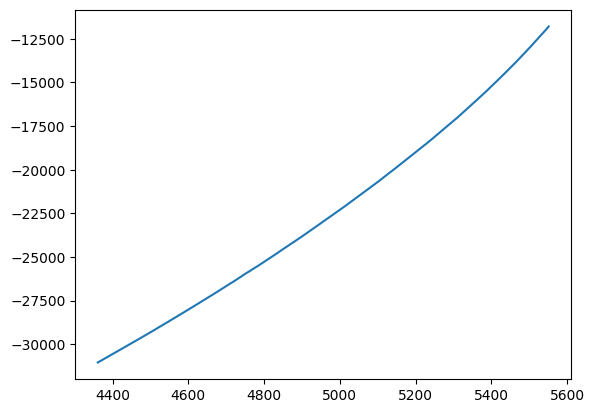

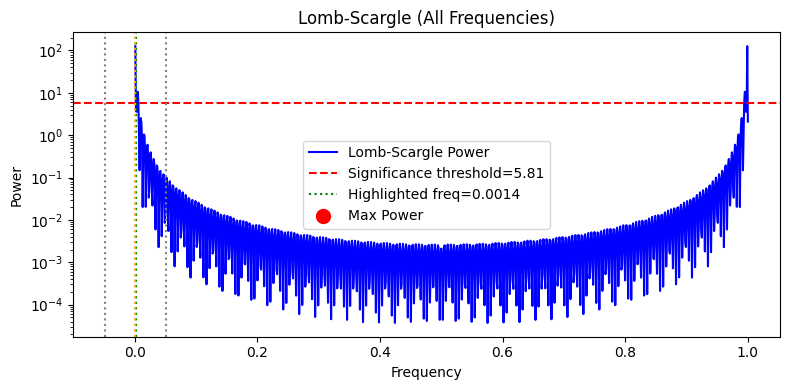

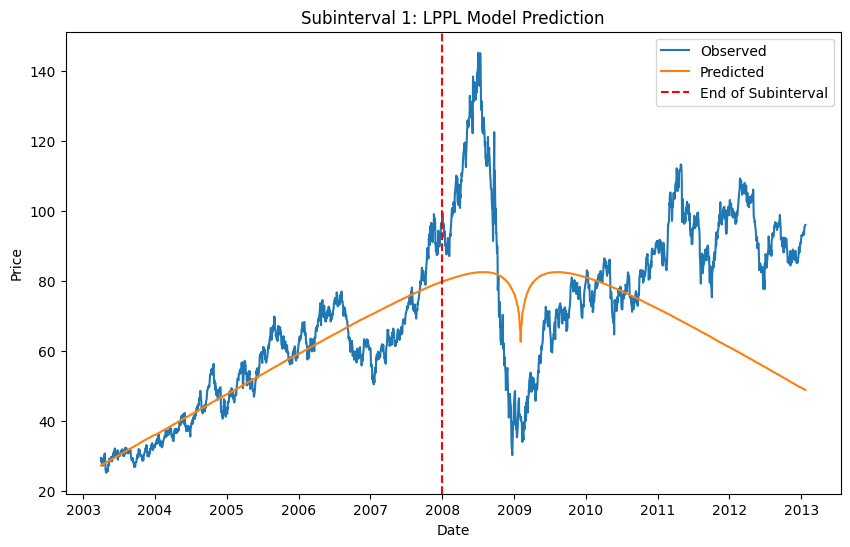

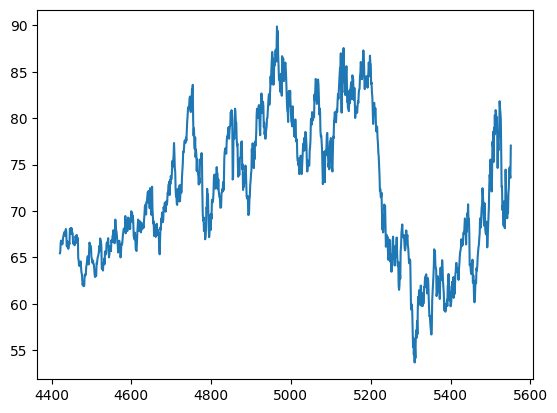

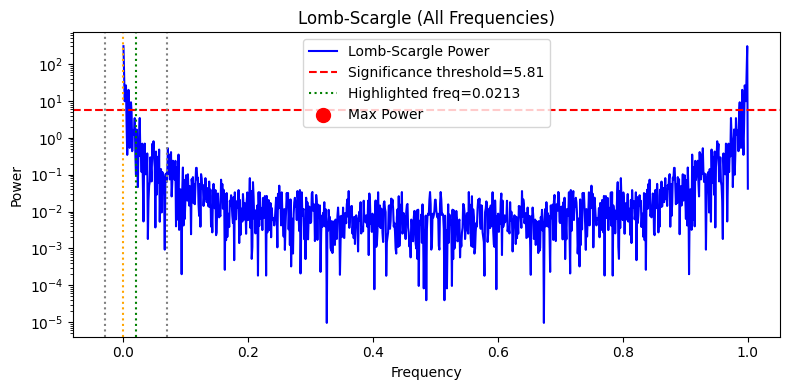

...

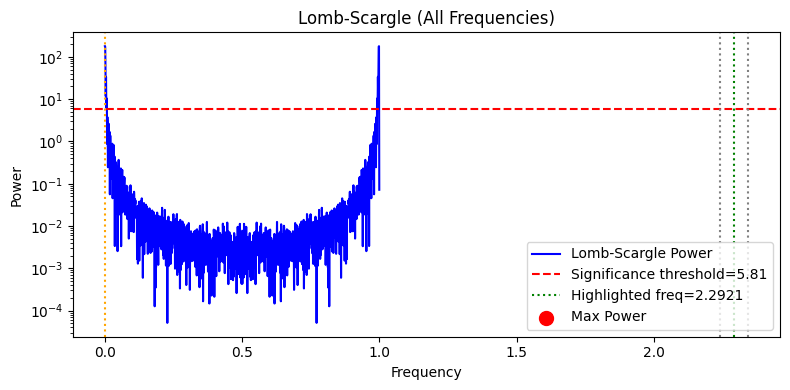

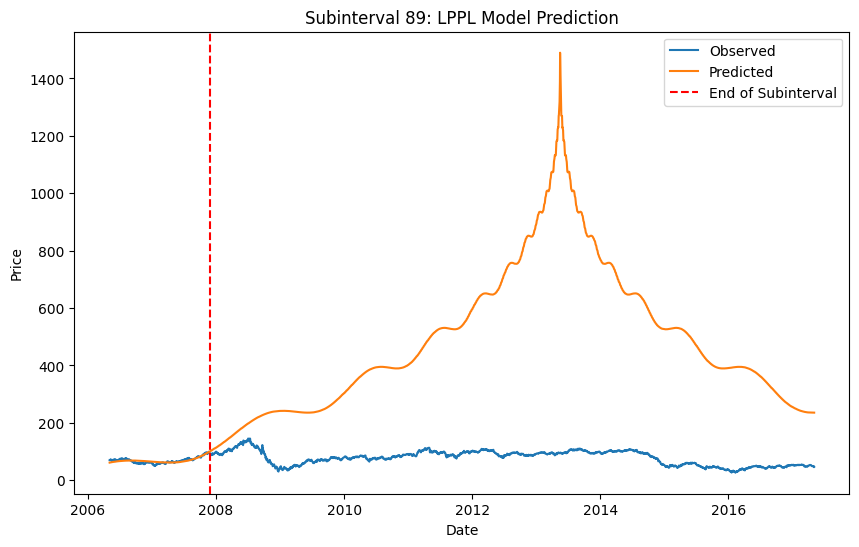

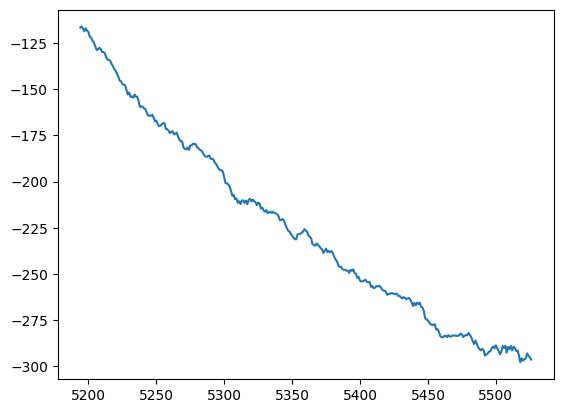

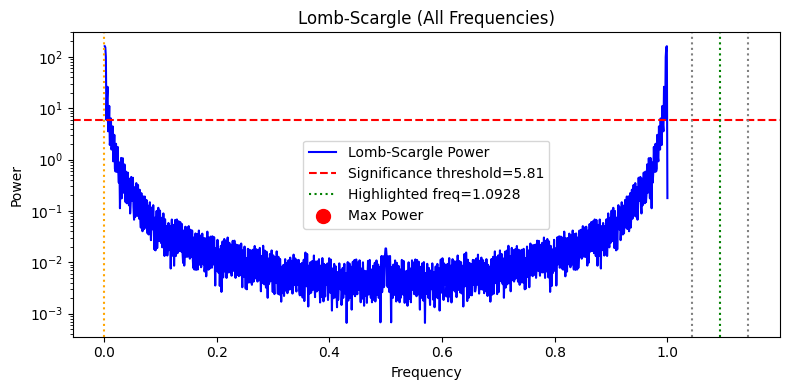

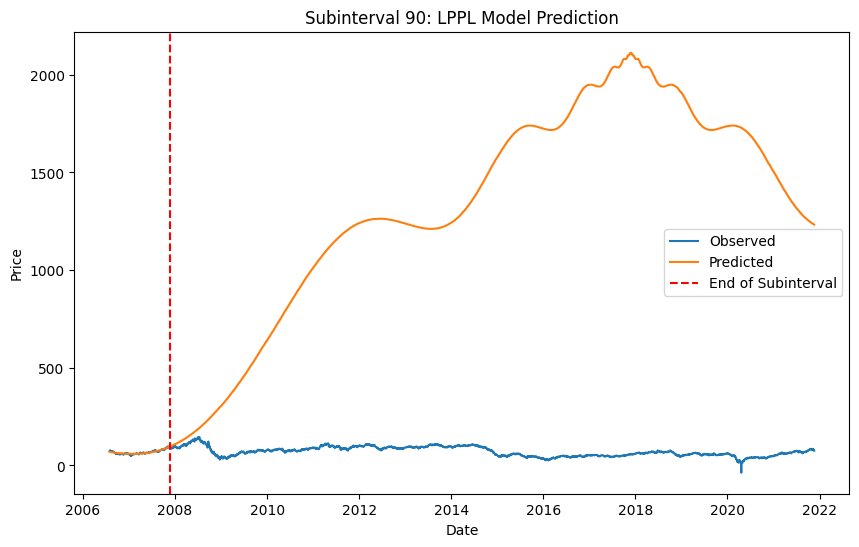

In [ ]:
from Utilities import load_data, select_sample
from MPGA import MPGA
import json

def lppl(t, A, B, tc, alpha, C, omega, phi):
    return A + B * np.abs(tc - t) ** alpha + C * np.abs(tc - t) ** alpha * np.cos(omega * np.log(np.abs(tc - t)) + phi)


# Exemple d'utilisation
file_path = 'WTI_Spot_Price_daily.csv'
data = load_data(file_path)

with open("results_1st_interval.json", "r") as f:
    results = json.load(f)

validated_solutions = []

t = np.linspace(0, len(data) - 1, len(data))

global_dates = data[:, 0]

data = np.insert(data, 0, t, axis=1)

data = data[:, [0, 2]].astype(float)

global_time = data[:, 0]
global_price = data[:, 1]

import numpy as np
from astropy.timeseries import LombScargle
import matplotlib.pyplot as plt

for i in range(len(results['subintervals'])):

    t_start = results['subintervals'][i]['sub_start']
    t_end = results['subintervals'][i]['sub_end']
    rss_val = results['subintervals'][i]['bestObjV']
    params = results['subintervals'][i]['bestChrom']
    tc, omega, phi, alpha = params

    freqs = np.linspace(0.0, 1.0, 1000)

    mask = (global_time >= t_start) & (global_time <= t_end)
    t_sub = global_time[mask]
    y_sub = global_price[mask]


    A, B, C = LombAnalysis.compute_linear_params(t_sub, y_sub, tc, alpha, omega, phi)
    x_sub = LombAnalysis.compute_residuals(t_sub, y_sub, A, B, tc, alpha)
    
    # Plot x_sub to check
    plt.plot(t_sub, x_sub)

    Lomb = LombAnalysis(t=t_sub, x=x_sub, freqs=freqs)
    Lomb.compute_lomb_periodogram(use_package=False)
    Lomb.filter_results()
    Lomb.show_spectrum(use_filtered=False, highlight_freq=omega/(2*np.pi), show_threshold=True, show_max_power=True)

    extended_t_sub = np.arange(t_sub[0], round(tc) + 1000)
    extended_y_sub = global_price[int(extended_t_sub[0]):int(extended_t_sub[-1] + 1)]
    extended_dates_sub = global_dates[int(extended_t_sub[0]):int(extended_t_sub[-1] + 1)]

    y_pred = lppl(extended_t_sub, A, B, tc, alpha, C, omega, phi)

    end_date = global_dates[int(t_sub[-1])]

    plt.figure(figsize=(10, 6))
    plt.plot(extended_dates_sub, extended_y_sub, label='Observed')
    plt.plot(extended_dates_sub, y_pred, label='Predicted')
    plt.axvline(x=end_date, color='r', linestyle='--', label='End of Subinterval')
    plt.xlabel('Date')
    plt.ylabel('Price')
    plt.title(f'Subinterval {i+1}: LPPL Model Prediction')
    plt.legend()
    plt.show()

    

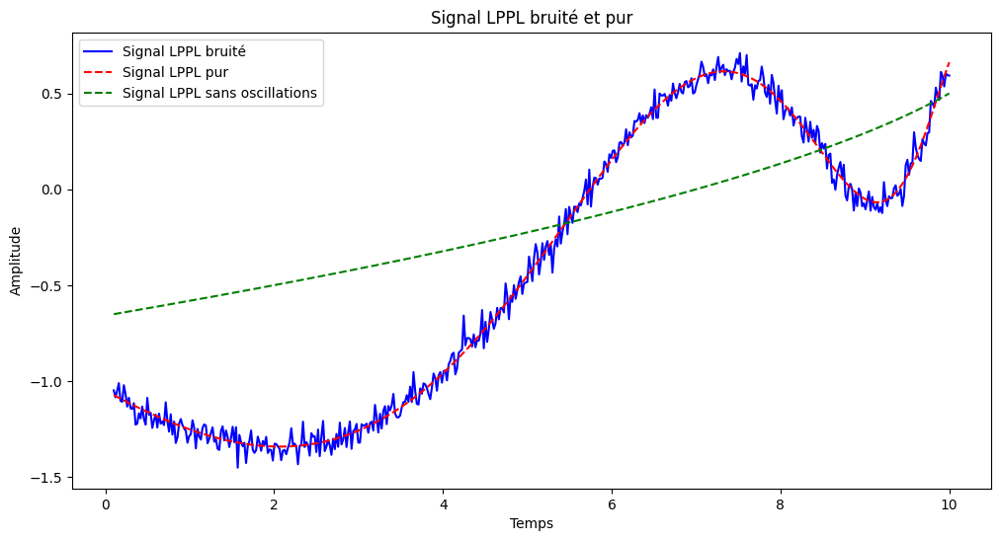

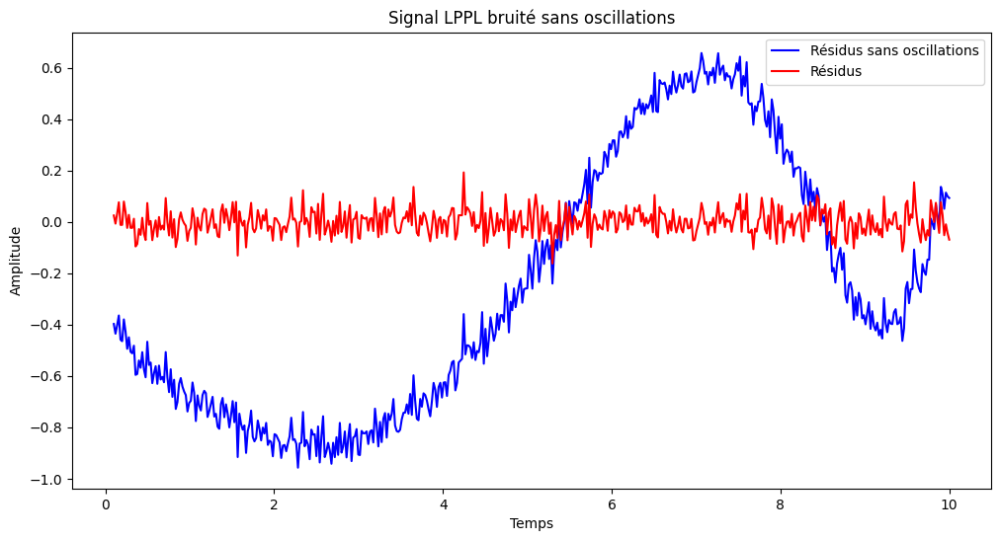

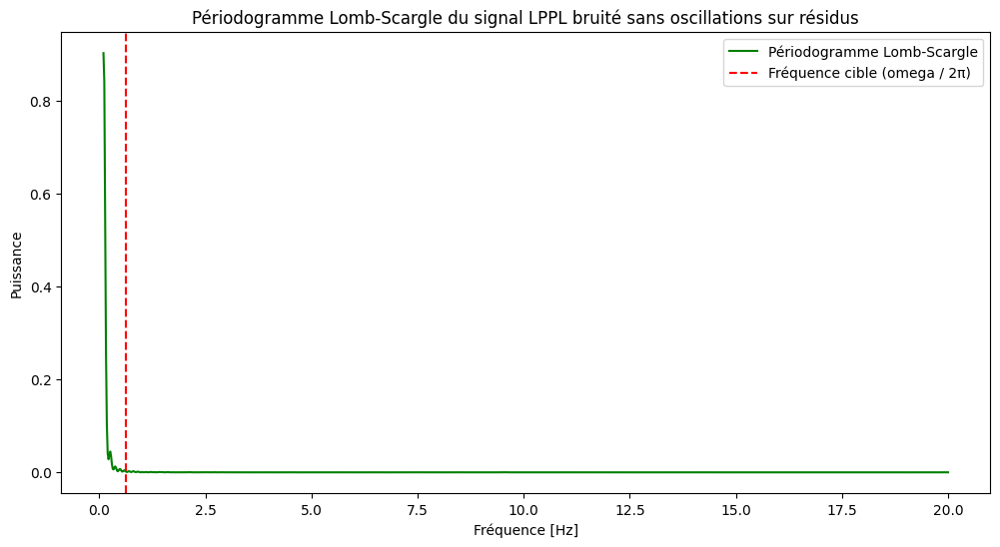

Fréquence avec la puissance maximale : 0.10 Hz
0.6366197723675814


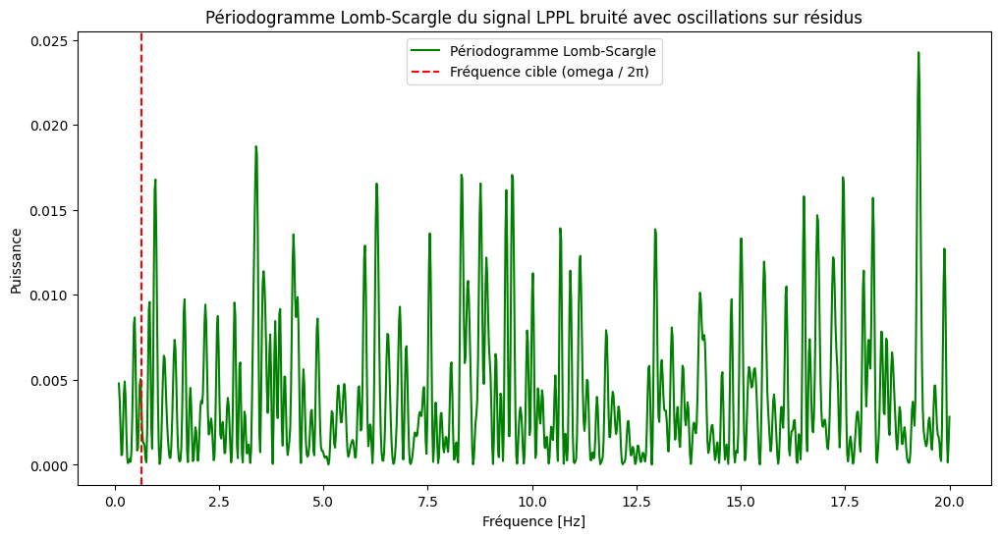

Fréquence avec la puissance maximale : 19.26 Hz


In [41]:
import numpy as np
import matplotlib.pyplot as plt
from astropy.timeseries import LombScargle

# Fonction pour générer un signal LPPL
def generate_lppl(t, A, B, C, tc, alpha, omega, phi, noise_std=0.0):
    """
    Génère un signal LPPL bruité.

    Paramètres
    ----------
    t : ndarray
        Temps (array 1D).
    A, B, C : float
        Paramètres linéaires.
    tc, alpha, omega, phi : float
        Paramètres non-linéaires.
    noise_std : float
        Écart-type du bruit à ajouter.

    Retourne
    -------
    y : ndarray
        Signal LPPL bruité.
    """
    dt = tc - t
    lppl = A + B * dt ** alpha + C * dt ** alpha * np.cos(omega * np.log(dt) + phi)
    noise = np.random.normal(scale=noise_std, size=t.shape)
    return lppl + noise

# Fonction pour générer un signal LPPL
def generate_lppl_without_oscillation(t, A, B, C, tc, alpha, omega, phi, noise_std=0.0):
    """
    Génère un signal LPPL bruité.

    Paramètres
    ----------
    t : ndarray
        Temps (array 1D).
    A, B, C : float
        Paramètres linéaires.
    tc, alpha, omega, phi : float
        Paramètres non-linéaires.
    noise_std : float
        Écart-type du bruit à ajouter.

    Retourne
    -------
    y : ndarray
        Signal LPPL sans oscillations bruité.
    """
    dt = tc - t
    lppl = A + B * dt ** alpha
    noise = np.random.normal(scale=noise_std, size=t.shape)
    return lppl + noise

# Étape 1 : Générer le signal LPPL bruité
np.random.seed(42)
t = np.linspace(0.1, 10, 500)  # Temps (évite le log(0) en commençant à 0.1)

# Paramètres LPPL
A, B, C = 1.0, -0.5, 0.3
tc, alpha, omega, phi = 11, 0.5, 4.0, 1.0
noise_std = 0.05  # Écart-type du bruit

# Génération du signal
lppl_signal = generate_lppl(t, A, B, C, tc, alpha, omega, phi, noise_std)
lppl_signal_without_oscillation = generate_lppl_without_oscillation(t, A, B, C, tc, alpha, omega, phi, noise_std)

x = lppl_signal - generate_lppl_without_oscillation(t, A, B, C, tc, alpha, omega, phi, 0)

# Étape 2 : Tracer le signal
plt.figure(figsize=(12, 6))
plt.plot(t, lppl_signal, label="Signal LPPL bruité", color="blue")
plt.plot(t, generate_lppl(t, A, B, C, tc, alpha, omega, phi, 0), label="Signal LPPL pur", color="red", linestyle="--")
plt.plot(t, generate_lppl_without_oscillation(t, A, B, C, tc, alpha, omega, phi, 0), label="Signal LPPL sans oscillations", color="green", linestyle="--")
plt.xlabel("Temps")
plt.ylabel("Amplitude")
plt.title("Signal LPPL bruité et pur")
plt.legend()
plt.show()


plt.figure(figsize=(12, 6))
plt.plot(t, lppl_signal - generate_lppl_without_oscillation(t, A, B, C, tc, alpha, omega, phi, 0), label="Résidus sans oscillations", color="blue")
plt.plot(t, lppl_signal - generate_lppl(t, A, B, C, tc, alpha, omega, phi, 0), label="Résidus", color="red")
plt.xlabel("Temps")
plt.ylabel("Amplitude")
plt.title("Signal LPPL bruité sans oscillations")
plt.legend()
plt.show()



# Étape 3 : Analyse de Lomb-Scargle sur le signal LPPL bruité
freqs = np.linspace(0.1, 20, 1000)  # Fréquences candidates
ls = LombScargle(t, lppl_signal - generate_lppl_without_oscillation(t, A, B, C, tc, alpha, omega, phi, 0))
power = ls.power(freqs)

# Étape 4 : Tracer le périodogramme de Lomb-Scargle
plt.figure(figsize=(12, 6))
plt.plot(freqs, power, color="green", label="Périodogramme Lomb-Scargle")
plt.axvline(omega / (2 * np.pi), color="red", linestyle="--", label="Fréquence cible (omega / 2π)")
plt.xlabel("Fréquence [Hz]")
plt.ylabel("Puissance")
plt.title("Périodogramme Lomb-Scargle du signal LPPL bruité sans oscillations sur résidus")
plt.legend()
plt.show()

idx = np.argmax(power)
best_freq = freqs[idx]
print(f"Fréquence avec la puissance maximale : {best_freq:.2f} Hz")

test = omega % (2 * np.pi)
print(test / (2 * np.pi))



# Étape 3 : Analyse de Lomb-Scargle sur le signal LPPL bruité
freqs = np.linspace(0.1, 20, 1000)  # Fréquences candidates
ls = LombScargle(t, lppl_signal - generate_lppl(t, A, B, C, tc, alpha, omega, phi, 0))
power = ls.power(freqs)

# Étape 4 : Tracer le périodogramme de Lomb-Scargle
plt.figure(figsize=(12, 6))
plt.plot(freqs, power, color="green", label="Périodogramme Lomb-Scargle")
plt.axvline(omega / (2 * np.pi), color="red", linestyle="--", label="Fréquence cible (omega / 2π)")
plt.xlabel("Fréquence [Hz]")
plt.ylabel("Puissance")
plt.title("Périodogramme Lomb-Scargle du signal LPPL bruité avec oscillations sur résidus")
plt.legend()
plt.show()

idx = np.argmax(power)
best_freq = freqs[idx]
print(f"Fréquence avec la puissance maximale : {best_freq:.2f} Hz")

In [34]:
120 % (2 * np.pi)

0.6194791635878616

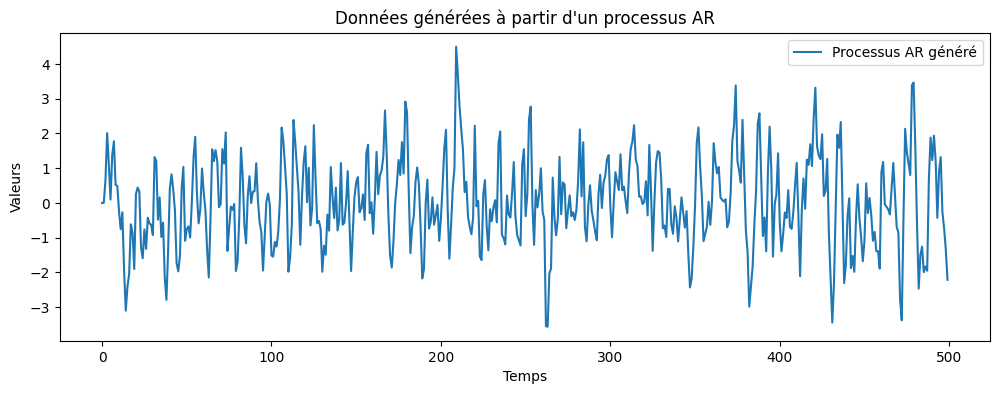

Coefficients estimés : [ 0.00642489  0.75013465 -0.26250478]


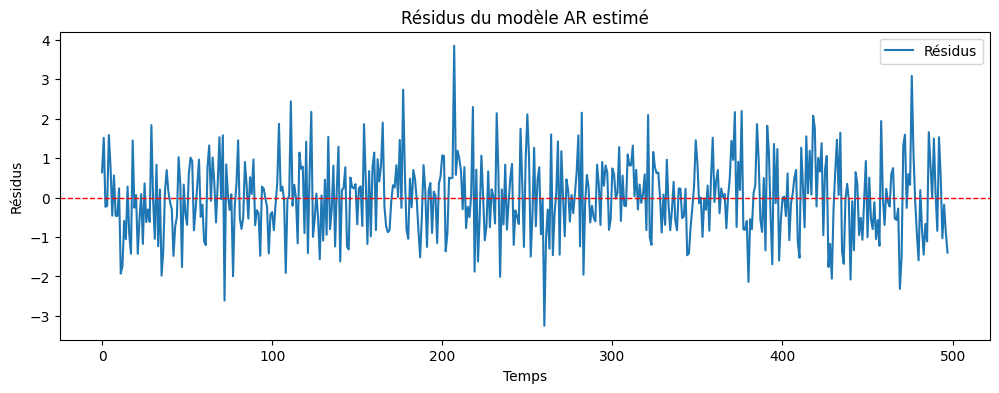

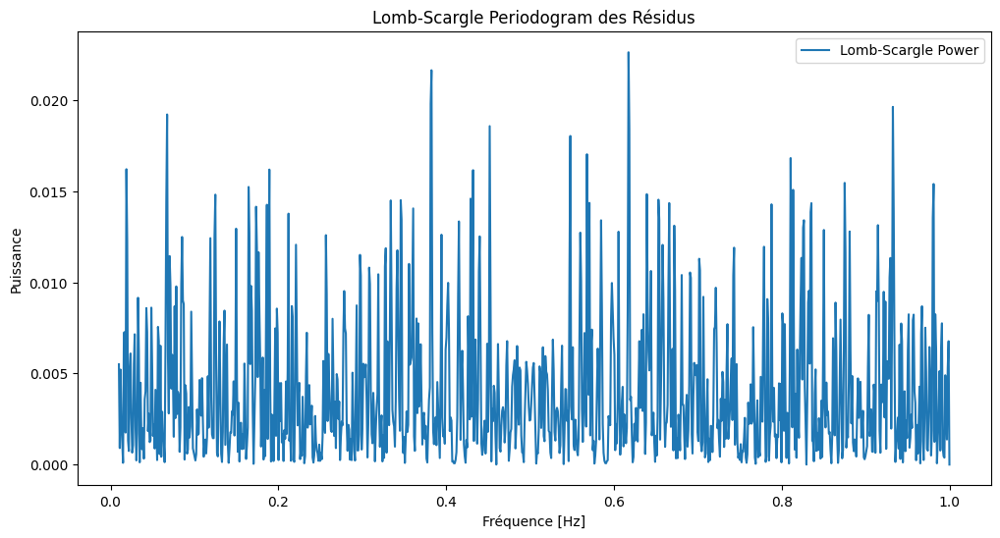

In [3]:
import numpy as np
import matplotlib.pyplot as plt
from statsmodels.tsa.ar_model import AutoReg
from astropy.timeseries import LombScargle

# Étape 1 : Génération des données AR
np.random.seed(42)
n = 500  # Nombre de points
ar_coefs = [0.75, -0.25]  # Coefficients du processus AR
noise_std = 1.0  # Écart-type du bruit

# Génération des données AR
y = np.zeros(n)
noise = np.random.normal(scale=noise_std, size=n)
for t in range(len(ar_coefs), n):
    y[t] = sum(ar_coefs[i] * y[t - i - 1] for i in range(len(ar_coefs))) + noise[t]

# Tracer les données générées
plt.figure(figsize=(12, 4))
plt.plot(y, label="Processus AR généré")
plt.xlabel("Temps")
plt.ylabel("Valeurs")
plt.title("Données générées à partir d'un processus AR")
plt.legend()
plt.show()

# Étape 2 : Ajustement d'un modèle AR
model = AutoReg(y, lags=len(ar_coefs), old_names=False)
fit = model.fit()
print(f"Coefficients estimés : {fit.params}")

# Étape 3 : Calcul des résidus
residuals = fit.resid

# Tracer les résidus
plt.figure(figsize=(12, 4))
plt.plot(residuals, label="Résidus")
plt.axhline(0, color='red', linestyle='--', linewidth=1)
plt.xlabel("Temps")
plt.ylabel("Résidus")
plt.title("Résidus du modèle AR estimé")
plt.legend()
plt.show()

# Étape 4 : Application de Lomb-Scargle sur les résidus
# Générer une série de temps pour les résidus
t = np.arange(len(residuals))

# Fréquences pour Lomb-Scargle
freqs = np.linspace(0.01, 1, 1000)

# Calcul du Lomb-Scargle periodogram
ls = LombScargle(t, residuals)
power = ls.power(freqs)

# Tracer le periodogramme de Lomb-Scargle
plt.figure(figsize=(12, 6))
plt.plot(freqs, power, label="Lomb-Scargle Power")
plt.xlabel("Fréquence [Hz]")
plt.ylabel("Puissance")
plt.title("Lomb-Scargle Periodogram des Résidus")
plt.legend()
plt.show()

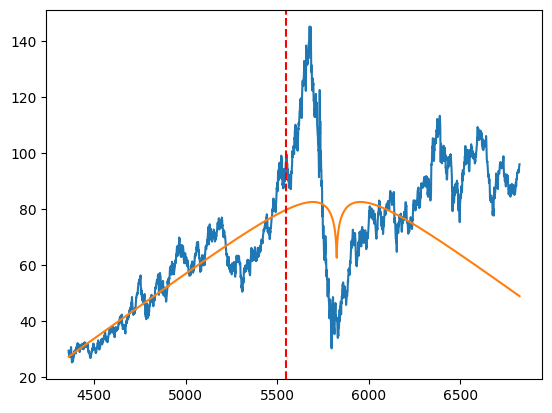

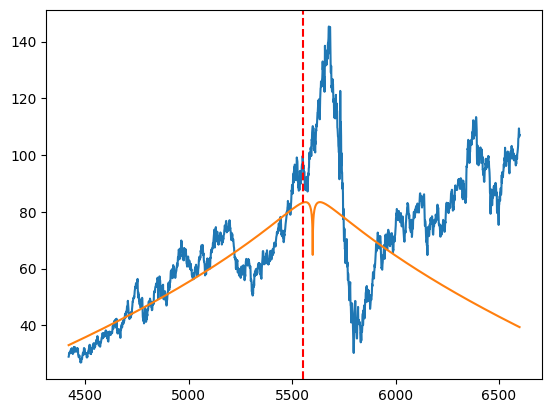

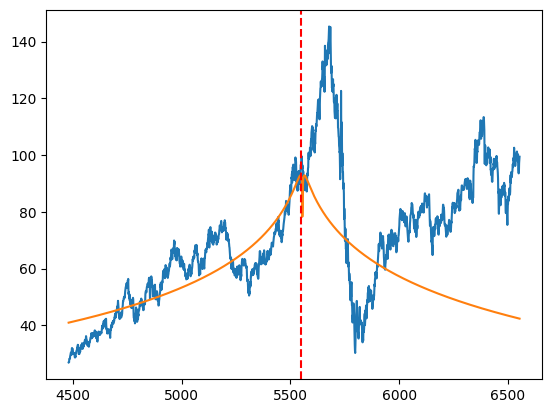

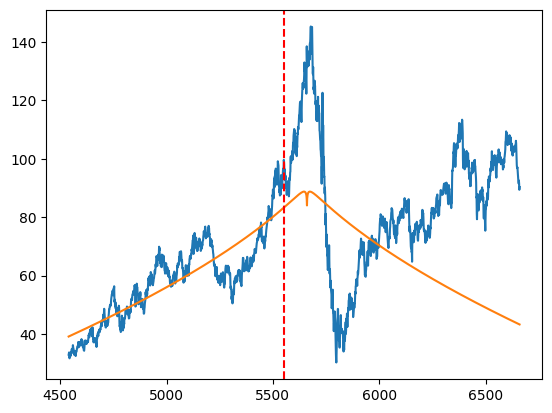

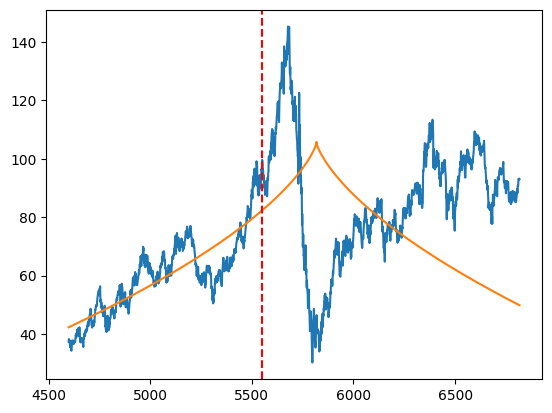

...

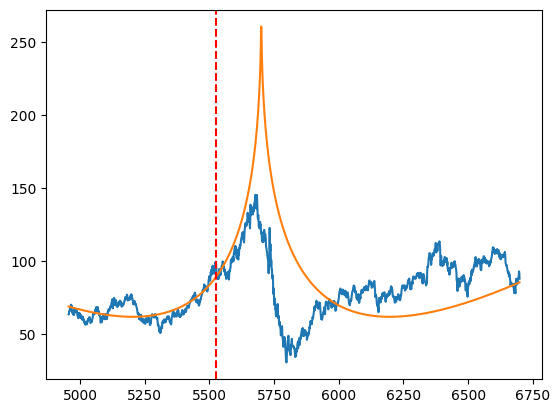

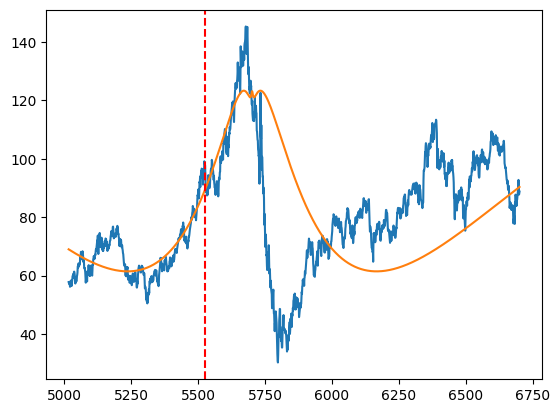

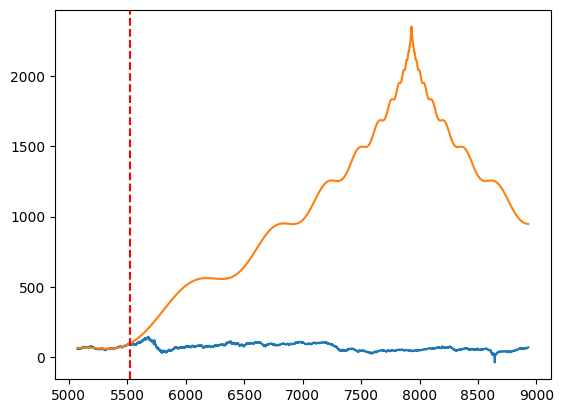

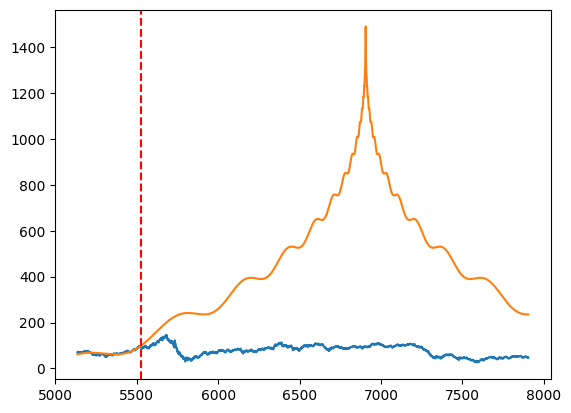

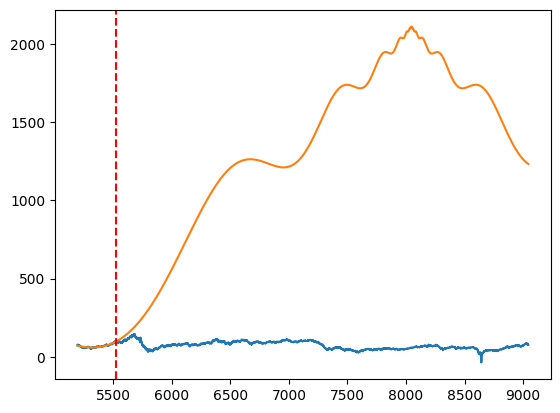

In [27]:


def lppl(t, A, B, tc, alpha, C, omega, phi):
    return A + B * np.abs(tc - t) ** alpha + C * np.abs(tc - t) ** alpha * np.cos(omega * np.log(np.abs(tc - t)) + phi)

validated_solutions = []

t = np.linspace(0, len(data) - 1, len(data))

global_dates = data[:, 0]

data = np.insert(data, 0, t, axis=1)

data = data[:, [0, 2]].astype(float)

global_time = data[:, 0]
global_price = data[:, 1]


for i in range(len(results['subintervals'])):

    t_start = results['subintervals'][i]['sub_start']
    t_end = results['subintervals'][i]['sub_end']
    rss_val = results['subintervals'][i]['bestObjV']
    params = results['subintervals'][i]['bestChrom']
    tc, omega, phi, alpha = params

    freqs = np.linspace(0.01, 1, 1000)
    # 1) Extract your subinterval data from the global dataset
    #    Or if you already have it, just pass it in directly.
    mask = (global_time >= t_start) & (global_time <= t_end)
    dates_sub = global_dates[mask]
    t_sub = global_time[mask]
    y_sub = global_price[mask]
    extended_t_sub = np.arange(t_sub[0], round(tc) + 1000)
    extended_y_sub = global_price[int(extended_t_sub[0]):int(extended_t_sub[-1] + 1)]
    extended_dates_sub = global_dates[int(extended_t_sub[0]):int(extended_t_sub[-1] + 1)]


    A, B, C = LombAnalysis.compute_linear_params(t_sub, y_sub, tc, alpha, omega, phi)

    y_pred = lppl(extended_t_sub, A, B, tc, alpha, C, omega, phi)


    # plot y_pred vs y_sub
    plt.plot(extended_dates_sub, extended_y_sub)
    plt.plot(extended_dates_sub, y_pred)
    # Rajoute une ligne verticale pour la t_sub[-1]
    plt.axvline(x=t_sub[-1], color='r', linestyle='--')
    plt.show()


In [101]:
len(extended_t_sub)

2465

In [103]:
len(extended_y_sub)

2464

In [ ]:
extended_t_sub = np.arange(t_sub[0], round(tc) + 1000)



In [105]:

from lppls import lppls, data_loader
import numpy as np
import pandas as pd
from datetime import datetime as dt

data = data_loader.nasdaq_dotcom()
data = data.tail(130) # truncate to go faster, should leave (130-126)+1=5 days

In [106]:
data

,Date,Open,High,Low,Close,Adj Close,Volume
1433,1999-09-07,2840.120117,2860.159912,2833.020020,2837.260010,2837.260010,911230000
1434,1999-09-08,2824.020020,2851.120117,2806.600098,2808.739990,2808.739990,1005950000
1435,1999-09-09,2826.600098,2852.040039,2807.949951,2852.020020,2852.020020,1029970000
1436,1999-09-10,2880.729980,2897.530029,2855.280029,2887.060059,2887.060059,1129430000
1437,1999-09-13,2879.780029,2883.360107,2844.760010,2844.770020,2844.770020,984440000
...,...,...,...,...,...,...,...
1558,2000-03-06,4935.649902,4980.149902,4887.879883,4904.850098,4904.850098,2015580000
1559,2000-03-07,4991.970215,5006.779785,4829.879883,4847.839844,4847.839844,2156410000
1560,2000-03-08,4920.859863,4923.140137,4722.140137,4897.259766,4897.259766,2020130000
1561,2000-03-09,4913.080078,5047.959961,4857.569824,5046.859863,5046.859863,2006810000


In [107]:
# convert time to ordinal
time = [pd.Timestamp.toordinal(dt.strptime(t1, '%Y-%m-%d')) for t1 in data['Date']]

# create list of observation data
price = np.log(data['Adj Close'].values)

# create observations array (expected format for LPPLS observations)
observations = np.array([time, price])

# instantiate a new LPPLS model with the Nasdaq Dot-com bubble dataset
lppls_model = lppls.LPPLS(observations=observations)

# fit the model to the data and get back the params
res = lppls_model.compute_nested_fits(
    window_size=126, 
    smallest_window_size=21, 
    outer_increment=1, 
    inner_increment=5, 
    max_searches=25
)

/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/lppls/lppls.py:620: RuntimeWarning: invalid value encountered in log
  return (w / (2.0 * np.pi)) * np.log((tc - t1) / (tc - t2))


In [109]:
res

<xarray.DataArray (t2: 5, windowsizes: 21, params: 8)> Size: 7kB
array([[[ 7.30185000e+005,  7.30004000e+005,  2.44036507e+001,
         -1.02754200e+001,  2.96186567e-002,  7.72565018e-002,
          0.00000000e+000,  7.30469722e+005],
        [ 7.30185000e+005,  7.30004000e+005,  8.68979005e+000,
         -2.35140433e-003,  2.01676512e-004,  1.05520676e+000,
          0.00000000e+000,  7.30261115e+005],
        [ 7.30185000e+005,  7.30004000e+005,  7.92832564e+000,
          9.98152569e-005, -4.05110277e-005,  1.80844466e+000,
          0.00000000e+000,  7.30025961e+005],
        [ 7.30185000e+005,  7.30004000e+005, -8.05861135e+001,
          4.87464006e+002,  1.96608194e-001, -2.00483076e-001,
          0.00000000e+000,  7.34992510e+005],
        [ 7.30185000e+005,  7.30004000e+005, -2.62084407e-001,
         -4.98037984e+001,  4.98164505e+001,  5.01839497e-001,
          0.00000000e+000,  1.20277482e+006],
        [ 7.30185000e+005,  7.30004000e+005,  7.92011504e+000,
          5.76155821e+000, -5.76153707e+000,  2.06124488e+000,
          0.00000000e+000,  7.30044895e+005],
        [ 7.30185000e+005,  7.30004000e+005, -4.81388081e-001,
         -1.98258470e+000, -1.98276235e+000,  8.39509424e-001,
...
          3.97421506e+001, -3.94745290e+001,  4.18774367e-001,
          0.00000000e+000,  7.30106028e+005],
        [ 7.30189000e+005,  7.30010000e+005,  6.83983745e-002,
          4.83792795e+001, -4.83740035e+001,  5.98551158e-001,
          0.00000000e+000,  9.45703066e+005],
        [ 7.30189000e+005,  7.30010000e+005,  8.23663908e+000,
          1.53633437e-002,  3.85180545e-003,  6.37320908e-001,
          0.00000000e+000,  7.30124999e+005],
        [ 7.30189000e+005,  7.30010000e+005,  8.25620823e+000,
          3.20321037e-002, -1.43187042e-002,  4.41150344e-001,
          0.00000000e+000,  7.30131000e+005],
        [ 7.30189000e+005,  7.30010000e+005,  8.26115902e+000,
          1.07426475e-002, -4.63707277e-003,  1.00306280e+000,
          0.00000000e+000,  7.30147993e+005],
        [ 7.30189000e+005,  7.30010000e+005,  7.85442764e+000,
          2.43713174e-001,  1.07034914e-002,  2.44049719e-001,
          0.00000000e+000,  7.30136868e+005],
        [ 7.30189000e+005,  7.30010000e+005,  8.31452057e+000,
          8.07907743e-003,  1.42533698e-003,  8.20661363e-001,
          0.00000000e+000,  7.30146328e+005]]])
Coordinates:
  * t2           (t2) float64 40B 7.302e+05 7.302e+05 ... 7.302e+05 7.302e+05
  * windowsizes  (windowsizes) int64 168B 21 26 31 36 41 ... 101 106 111 116 121
  * params       (params) <U2 64B 't2' 't1' 'a' 'b' 'c' 'm' '0' 'tc'

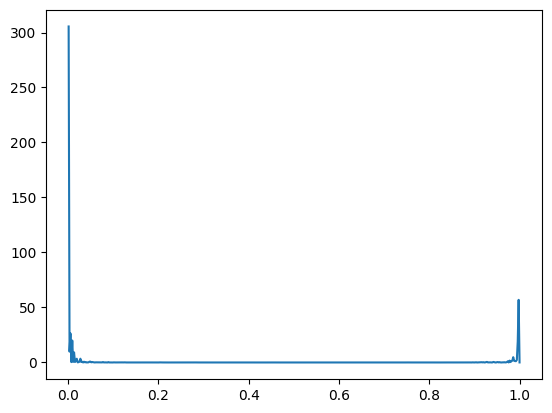

In [26]:
# Dense plot de P
import matplotlib.pyplot as plt

plt.plot(np.linspace(0.001, 1.0, 500), P)

In [23]:
data

array([[Timestamp('1986-01-02 00:00:00'), 25.56],
       [Timestamp('1986-01-03 00:00:00'), 26.0],
       [Timestamp('1986-01-06 00:00:00'), 26.53],
       ...,
       [Timestamp('2024-12-05 00:00:00'), 68.58],
       [Timestamp('2024-12-06 00:00:00'), 68.58],
       [Timestamp('2024-12-09 00:00:00'), 68.65]], dtype=object)

In [22]:
def lomb_periodogram(t, x, freqs, p=0.95):
    """
    Perform Lomb periodogram analysis for the given time series x at times t with a set of frequencies.

    Parameters:
    - t: Time points (array)
    - x: Observed values (array)
    - freqs: Frequency series to test (array)
    - p: Statistical significance level (default 0.95)

    Returns:
    - P: Power spectral density for each frequency in freqs
    - valid_freq: The frequency with the highest valid power
    """
    J = len(t)
    mean_x = 1/J * np.sum(x)  # mean of x
    var_x = 1/(J-1) * np.sum((x - mean_x) **2) # variance of x
    P = []

    # Compute the Lomb periodogram for each frequency
    for f in freqs:
        # Calculate time offset t
        sin_term = np.sum(np.sin(4 * np.pi * f * t))
        cos_term = np.sum(np.cos(4 * np.pi * f * t))
        t_offset = (1 / (4 * np.pi * f)) * np.arctan(sin_term / cos_term)

        # Calculate power spectral density P(f)
        cos_num = np.sum((x - mean_x) * np.cos(2 * np.pi * f * (t - t_offset))) ** 2
        cos_denom = np.sum(np.cos(2 * np.pi * f * (t - t_offset)) ** 2)
        sin_num = np.sum((x - mean_x) * np.sin(2 * np.pi * f * (t - t_offset))) ** 2
        sin_denom = np.sum(np.sin(2 * np.pi * f * (t - t_offset)) ** 2)
        power = (cos_num/cos_denom + sin_num/sin_denom) / (2 * var_x)
        P.append(power)

    # Convert to array for convenience
    P = np.array(P)

    # Calculate critical value based on statistical significance level p
    M = len(freqs)
    critical_value = -np.log(1 - (1 - p) ** (1 / M))

    # Find valid frequencies based on power being greater than the critical value
    valid_freqs = freqs[P > critical_value]

    # If no valid frequencies, return None
    if len(valid_freqs) == 0:
        return None, None

    # Select the frequency with the maximum power
    max_power_idx = np.argmax(P)
    valid_freq = freqs[max_power_idx]

    return P, valid_freq

In [8]:
data

array([[0.0, 0.0, Timestamp('1986-01-02 00:00:00'), 25.56],
       [1.0, 1.0, Timestamp('1986-01-03 00:00:00'), 26.0],
       [2.0, 2.0, Timestamp('1986-01-06 00:00:00'), 26.53],
       ...,
       [9803.0, 9803.0, Timestamp('2024-12-05 00:00:00'), 68.58],
       [9804.0, 9804.0, Timestamp('2024-12-06 00:00:00'), 68.58],
       [9805.0, 9805.0, Timestamp('2024-12-09 00:00:00'), 68.65]],
      dtype=object)

In [3]:
# arrondi en int t_c_list
t_c_list = [int(round(t_c)) for t_c in t_c_list]

In [4]:
t_c_list

[9491,
 8623,
 10019,
 8464,
 9431,
 9967,
 8566,
 9213,
 9928,
 8829,
 8262,
 8727,
 7879,
 8686,
 7907,
 8990,
 7963,
 8715,
 7802,
 9485,
 7846,
 8277,
 9306,
 9595,
 8381,
 8392,
 9419,
 7946,
 7868,
 8058,
 9783,
 8934,
 8536,
 9870,
 7812,
 8083,
 9092,
 9007,
 9640,
 8952,
 8570,
 8391,
 9599,
 7993,
 8462,
 9623,
 9342,
 9121,
 9020,
 8958,
 9762,
 10079,
 8244,
 8949,
 9630,
 8326,
 8577,
 7990,
 8272,
 8601,
 10074,
 9533,
 9300,
 9540,
 8582,
 10242,
 8422,
 8729,
 10203,
 8587,
 9366,
 7902,
 8457,
 8030,
 9263,
 9301,
 10238,
 8073,
 8464,
 8281,
 8923,
 9522,
 8679,
 8077,
 8154,
 8742,
 8983,
 8151,
 8605,
 9198]

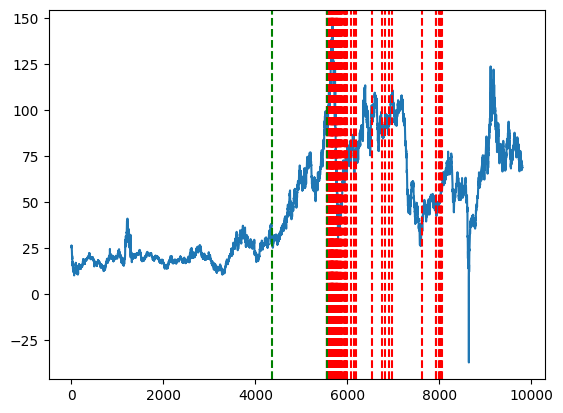

In [21]:
import pandas as pd
import matplotlib.pyplot as plt

t_c_list = []

for i in range(len(results['subintervals'])):
    t_c = results['subintervals'][i]['bestChrom'][0]
    t_c_list.append(int(round(t_c)))

df = pd.DataFrame(data, columns=['Date', 'Price'])
df['Date'] = pd.to_datetime(df['Date'])

t_c_list = [x for x in t_c_list if x <= len(df)]
t_c_date_list = df.iloc[t_c_list]['Date'].unique()


df['Price'].plot()
for t_c in t_c_list:
    # plot une ligne verticale pour chaque t_c
    plt.axvline(x=t_c, color='r', linestyle='--')

# rajoute en verre time_start et time_end
time_start = df[df['Date'] == time_start].index[0]
time_end = df[df['Date'] == time_end].index[0]

plt.axvline(x=time_start, color='g', linestyle='--')
plt.axvline(x=time_end, color='g', linestyle='--')

plt.show()





In [ ]:
#  supprime ce qui est supérieur à 9800 dans la list t_c_list



In [16]:
df

,Date,Price
0,1986-01-02,25.56
1,1986-01-03,26.0
2,1986-01-06,26.53
3,1986-01-07,25.85
4,1986-01-08,25.87
...,...,...
9801,2024-12-03,70.15
9802,2024-12-04,68.81
9803,2024-12-05,68.58
9804,2024-12-06,68.58


<DatetimeArray>
['2023-09-05 00:00:00', '2020-03-20 00:00:00', '2019-08-01 00:00:00',
 '2023-06-08 00:00:00', '2019-12-27 00:00:00', '2022-07-27 00:00:00',
 '2021-01-14 00:00:00', '2018-10-05 00:00:00', '2020-08-18 00:00:00',
 '2017-03-29 00:00:00', '2020-06-19 00:00:00', '2017-05-09 00:00:00',
 '2021-09-03 00:00:00', '2017-07-31 00:00:00', '2020-07-31 00:00:00',
 '2016-12-06 00:00:00', '2023-08-25 00:00:00', '2017-02-09 00:00:00',
 '2018-10-26 00:00:00', '2022-12-07 00:00:00', '2024-02-06 00:00:00',
 '2019-04-02 00:00:00', '2019-04-17 00:00:00', '2023-05-22 00:00:00',
 '2017-07-06 00:00:00', '2017-03-14 00:00:00', '2017-12-13 00:00:00',
 '2024-11-05 00:00:00', '2021-06-16 00:00:00', '2019-11-13 00:00:00',
 '2016-12-20 00:00:00', '2018-01-22 00:00:00', '2022-02-01 00:00:00',
 '2021-09-29 00:00:00', '2024-04-11 00:00:00', '2021-07-13 00:00:00',
 '2020-01-03 00:00:00', '2019-04-16 00:00:00', '2024-02-12 00:00:00',
 '2017-09-12 00:00:00', '2019-07-30 00:00:00', '2024-03-18 00:00:00',
 '20

In [15]:
import numpy as np

def compute_linear_params(t, y, t_c, alpha, omega, phi):
    """
    Placeholder that returns (A, B, C) for the subinterval data.

    You should implement the actual linear regression (Eq. 5 in your references),
    i.e. solve the system using f_j, g_j, etc.
    """

    dt = t_c - t
    f = dt ** alpha
    g = f * np.cos(omega * np.log(dt) + phi)

    # Build design matrix
    V = np.column_stack((np.ones_like(f), f, g))
 
    return np.linalg.inv(V.T @ V) @ (V.T @ y)

def compute_residuals(t, y, A, B, C, t_c, alpha, omega, phi):
    """
    Return the array x_j = y_j - [A + B(...) + C(...)cos(...)], for j=1..J
    """
    resid = np.empty_like(y, dtype=np.float64)
    for i in range(len(y)):
        dt = t_c - t[i]
        # If dt <= 0, watch out for domain issues (e.g. ln(dt))
        # but let's assume your intervals guarantee dt>0
        resid[i] = y[i] - (A 
                           + B * (dt ** alpha)
                           + C * (dt ** alpha) * np.cos(omega * np.log(dt) + phi))
    return resid

def lomb_power_spectrum(t, x, freq_array):
    """
    Compute the Lomb-Scargle periodogram P(f) for each f in freq_array.

    Parameters
    ----------
    t          : 1D array of time points t_j
    x          : 1D array of residuals x_j
    freq_array : 1D array of candidate frequencies f_i

    Returns
    -------
    power_spectrum : 1D array of P(f_i) for each frequency f_i
    """
    J = len(t)
    x_mean = np.mean(x)
    sigma2 = np.sum((x - x_mean)**2) / (J - 1)

    power_spectrum = np.zeros_like(freq_array)

    # Precompute some sums for speed if desired; for clarity, do it directly:
    for i, f in enumerate(freq_array):
        # Time shift tau
        sum_sin = 0.0
        sum_cos = 0.0
        for j in range(J):
            sum_sin += np.sin(4.0 * np.pi * f * t[j])
            sum_cos += np.cos(4.0 * np.pi * f * t[j])
        tau = (1.0 / (4.0 * np.pi * f)) * np.arctan2(sum_sin, sum_cos)

        # Numerators
        Nc = 0.0
        Ns = 0.0
        # Denominators
        Dc = 0.0
        Ds = 0.0

        for j in range(J):
            arg = 2.0 * np.pi * f * (t[j] - tau)
            xc = (x[j] - x_mean) * np.cos(arg)
            xs = (x[j] - x_mean) * np.sin(arg)
            Nc += xc
            Ns += xs
            Dc += np.cos(arg)**2
            Ds += np.sin(arg)**2

        # P(f)
        P_f = (1.0 / (2.0 * sigma2)) * ( (Nc**2 / Dc) + (Ns**2 / Ds) )
        power_spectrum[i] = P_f

    return power_spectrum


def filter_lomb_results(freq_array, power_array, J, p=0.95):
    """
    Remove invalid frequencies from the Lomb-Scargle result.
    1) Remove f_mpf ~ 1.5 / J
    2) Remove values below critical threshold.
    3) Return "filtered" freq and power arrays.
    """
    M = len(freq_array)

    # 1) f_mpf ~ 1.5/J
    mpf = 1.5 / J

    # 2) critical threshold:
    #    z = -ln(1 - (1 - p)^(1/M))
    #    -> if power < z, discard
    z = -np.log(1.0 - (1.0 - p)**(1.0 / M))

    filtered_f = []
    filtered_p = []
    for f, pwr in zip(freq_array, power_array):
        # skip if near f_mpf:
        if abs(f - mpf) < 1e-6:  
            continue
        # skip if pwr < z
        if pwr < z:
            continue
        filtered_f.append(f)
        filtered_p.append(pwr)

    return np.array(filtered_f), np.array(filtered_p)

def lomb_validation_for_subinterval(
    t, y,
    t_c, omega, phi, alpha,
    # Possibly we need A,B,C or we compute them:
    compute_linear=True,
    param_func=compute_linear_params,  # Placeholder to get (A,B,C)
    freq_array=np.linspace(0.001, 1.0, 500),  # Example freq range
    p=0.95
):
    """
    Perform Lomb-Scargle on x_j for a single subinterval and decide if the
    predicted turning point is valid.

    Returns: (is_valid, best_freq, best_power)
    """
    dt = t_c - t
    f = dt ** alpha
    g = f * np.cos(omega * np.log(dt) + phi)

    # Build design matrix
    V = np.column_stack((np.ones_like(f), f, g))
 
    A, B, C = np.linalg.inv(V.T @ V) @ (V.T @ y)

    # 2) Build x_j
    x = compute_residuals(t, y, A, B, C, t_c, alpha, omega, phi)

    # 3) Compute Lomb periodogram
    P = lomb_power_spectrum(t, x, freq_array)

    # 4) Filter invalid freq
    f_filt, P_filt = filter_lomb_results(freq_array, P, len(t), p=p)

    if len(f_filt) == 0:
        # no valid freq => invalid subinterval
        return (False, None, None)

    # 5) Identify peak frequency
    idx_peak = np.argmax(P_filt)
    best_freq = f_filt[idx_peak]
    best_power = P_filt[idx_peak]

    # 6) Compare best_freq ~ (omega / 2pi)
    #    Some tolerance: e.g., 5% difference
    target_freq = omega / (2.0 * np.pi)
    relative_diff = abs(best_freq - target_freq) / target_freq

    is_valid = (relative_diff < 0.05)  # or pick a suitable threshold
    return (is_valid, best_freq, best_power)

,Price
Date,
1986-01-02,25.56
1986-01-03,26.0
1986-01-06,26.53
1986-01-07,25.85
1986-01-08,25.87
...,...
2024-12-03,70.15
2024-12-04,68.81
2024-12-05,68.58
